In this notebook, we make use of the Google Cloud Vision API to accomplish two key functions. Firstly, the API is utilized to identify and extract brand logos from various images. Secondly, it is used to detect and gather information about different entities found within these images, covering a diverse array of categories. For those interested in exploring more about the functionalities and applications of this API, detailed information can be found on the Google Cloud Vision API's official documentation page.

<details>  This notebook primarily concentrates on analyzing data related to Lufthansa Air. However, by altering the file path to target 'singaporeair', the same analysis can be adapted and applied to SingaporeAir data.

In [1]:
import pandas as pd
# Imports the Google Cloud client library
from google.cloud import vision
import os

In [19]:
# test if connection to google cloud is valid 
def run_quickstart() -> vision.EntityAnnotation:
    """Provides a quick start example for Cloud Vision."""

    # Instantiates a client
    client = vision.ImageAnnotatorClient()

    # The URI of the image file to annotate
    file_uri = "gs://cloud-samples-data/vision/label/wakeupcat.jpg"

    image = vision.Image()
    image.source.image_uri = file_uri

    # Performs label detection on the image file
    response = client.label_detection(image=image)
    labels = response.label_annotations

    print("Labels:")
    for label in labels:
        print(label.description)

    return labels
run_quickstart()

Labels:
Cat
Window
Felidae
Carnivore
Jaw
Small to medium-sized cats
Gesture
Whiskers
Window blind
Fawn


[mid: "/m/01yrx"
description: "Cat"
score: 0.956459463
topicality: 0.956459463
, mid: "/m/0d4v4"
description: "Window"
score: 0.938840091
topicality: 0.938840091
, mid: "/m/0307l"
description: "Felidae"
score: 0.89566052
topicality: 0.89566052
, mid: "/m/01lrl"
description: "Carnivore"
score: 0.885138333
topicality: 0.885138333
, mid: "/m/01k9lj"
description: "Jaw"
score: 0.880326807
topicality: 0.880326807
, mid: "/m/07k6w8"
description: "Small to medium-sized cats"
score: 0.863107383
topicality: 0.863107383
, mid: "/m/0244x1"
description: "Gesture"
score: 0.852604866
topicality: 0.852604866
, mid: "/m/01l7qd"
description: "Whiskers"
score: 0.84995687
topicality: 0.84995687
, mid: "/m/031b6r"
description: "Window blind"
score: 0.834581673
topicality: 0.834581673
, mid: "/m/0276krm"
description: "Fawn"
score: 0.816135049
topicality: 0.816135049
]

## Functions

In [20]:
from google.cloud import vision
import pandas as pd

def detect_logos_batch(image_paths):
    """Detects logos in multiple files and returns a DataFrame."""
    client = vision.ImageAnnotatorClient()

    requests = []
    for path in image_paths:
        with open(path, "rb") as image_file:
            content = image_file.read()
        image = vision.Image(content=content)
        # Add a logo detection request for each image
        requests.append(vision.AnnotateImageRequest(image=image, features=[vision.Feature(type_=vision.Feature.Type.LOGO_DETECTION)]))

    response = client.batch_annotate_images(requests=requests)
    
    data = []
    for i, resp in enumerate(response.responses):
        logos = resp.logo_annotations
        if logos:
            for logo in logos:
                data.append({
                    "path": image_paths[i],
                    "Description": logo.description,
                    "Confidence": logo.score,
                    "Vertices": [(vertex.x, vertex.y) for vertex in logo.bounding_poly.vertices]
                })

    return pd.DataFrame(data) if data else None

In [21]:
from google.cloud import vision
import pandas as pd

def detect_labels_batch(image_paths):
    """Detects labels in multiple files and returns a DataFrame."""
    client = vision.ImageAnnotatorClient()

    requests = []
    for path in image_paths:
        with open(path, "rb") as image_file:
            content = image_file.read()
        image = vision.Image(content=content)
        # Add a label detection request for each image
        requests.append(vision.AnnotateImageRequest(image=image, features=[vision.Feature(type_=vision.Feature.Type.LABEL_DETECTION)]))

    response = client.batch_annotate_images(requests=requests)
    
    data = []
    for i, image_response in enumerate(response.responses):
        if image_response.error.message:
            raise Exception(
                f"{image_response.error.message}\nFor more info on error messages, check: "
                "https://cloud.google.com/apis/design/errors"
            )
        for label in image_response.label_annotations:
            data.append({
                "path": image_paths[i],
                "Description": label.description,
                "Confidence": label.score
            })

    return pd.DataFrame(data) if data else None




# Logo prediction

In [5]:
# define the dataset and name 

dataset= "/singaporeair"
name_file= "singaporeair"
dir=f"../data{dataset}/"

In [6]:
# get all the names of the jpg files in our Data repository
pic_names= [obs for obs in os.listdir(dir) if "jpg" in obs]
pic_paths = [os.path.join(dir, obs) for obs in pic_names]

len(pic_paths)

1898

## Calls to API and storing results in a csv file

In [41]:
dfs_batches = []
# Assuming pic_paths is a list of image paths
batch_size = 10
for i in range(0, len(pic_paths), batch_size):

    batch_paths = pic_paths[i:i + batch_size]
    df= detect_logos_batch(batch_paths)
    if df is not None:
        dfs_batches.append(df)
    if i%500==0:
        print(i)

0
500
1000
1500
2000


In [ ]:
if dfs_batches:
    print("the dataframe is not empty")
    combined_df = pd.concat(dfs_batches, ignore_index=True)

    # Save the DataFrame to a CSV file
    output_file = f"../additional_data/Google_API_results_logos/results_{name_file}.csv"
    combined_df.to_csv(output_file, index=False, sep=";")
    
combined_df

## Load data from csv and visualize

In [28]:
# read in the data
combined_df= pd.read_csv( f"../additional_data/Google_API_results_logos/results_{name_file}.csv" ,sep=";")
import ast
import pandas as pd

# Apply ast.literal_eval to each element in the Vertices column
# when writing/reading sth changes in the way the vertices are saved, therefore they need to be casted
combined_df["Vertices"] = combined_df["Vertices"].apply(ast.literal_eval)

[(513, 171), (588, 171), (588, 269), (513, 269)]


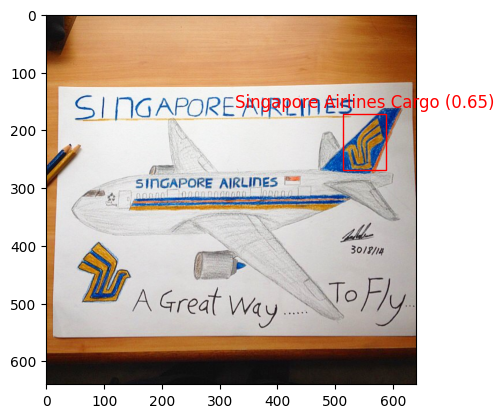

[(48, 387), (152, 387), (152, 508), (48, 508)]


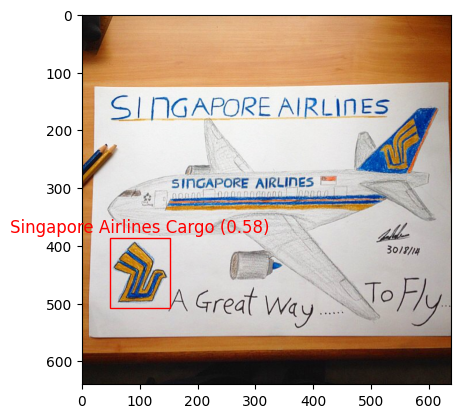

[(193, 531), (316, 531), (316, 589), (193, 589)]


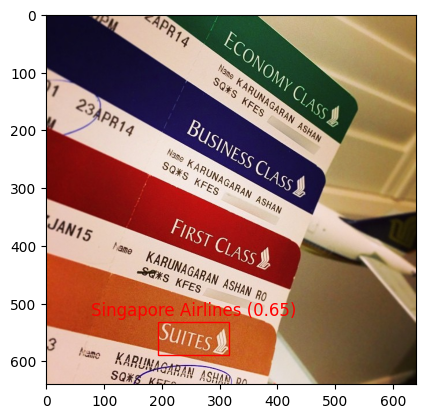

[(284, 8), (591, 8), (591, 84), (284, 84)]


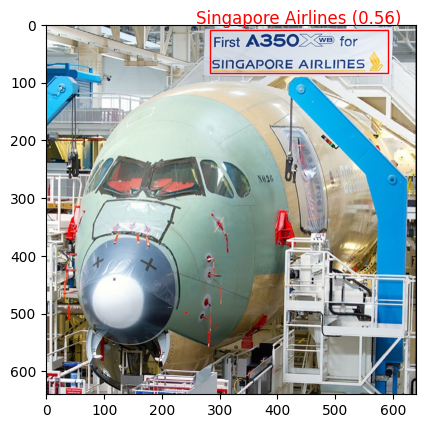

[(176, 177), (505, 177), (505, 235), (176, 235)]


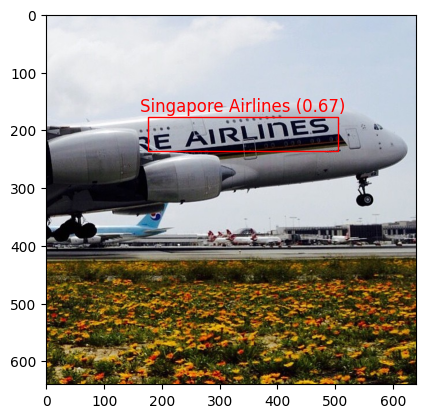

[(123, 248), (249, 248), (249, 309), (123, 309)]


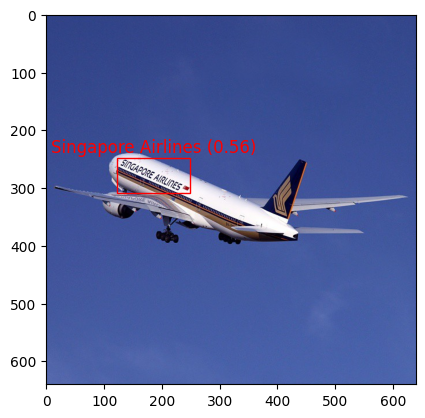

[(363, 223), (541, 223), (541, 274), (363, 274)]


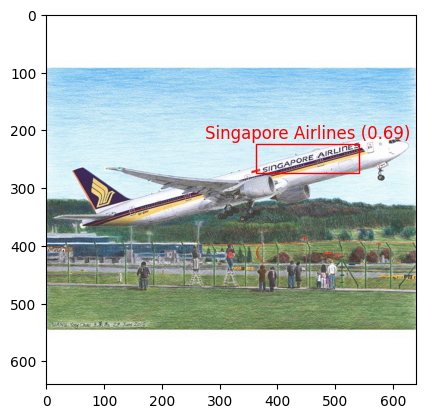

[(188, 289), (310, 289), (310, 329), (188, 329)]


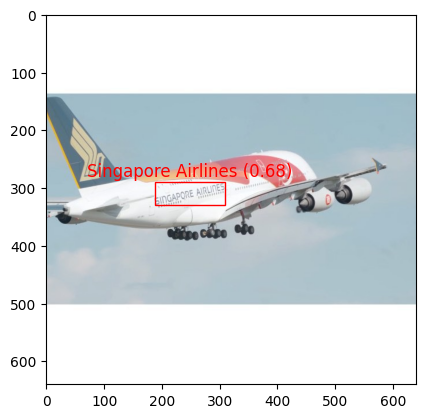

[(423, 448), (465, 448), (465, 498), (423, 498)]


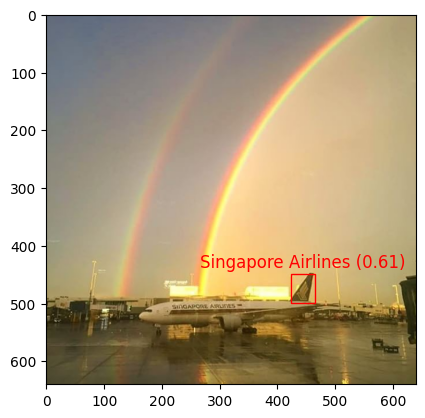

[(724, 158), (933, 158), (933, 213), (724, 213)]


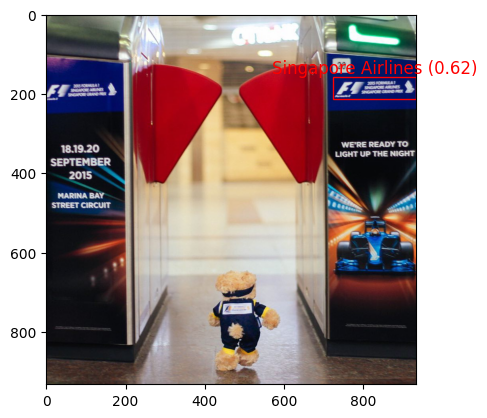

[(3, 165), (185, 165), (185, 220), (3, 220)]


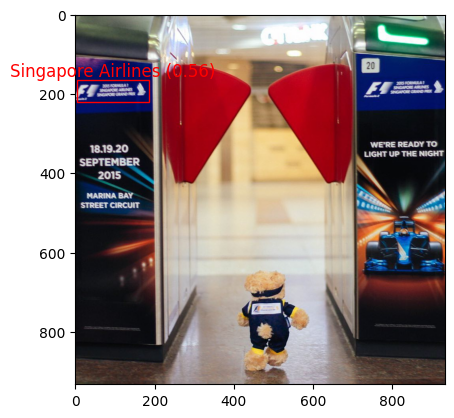

[(446, 235), (488, 235), (488, 299), (446, 299)]


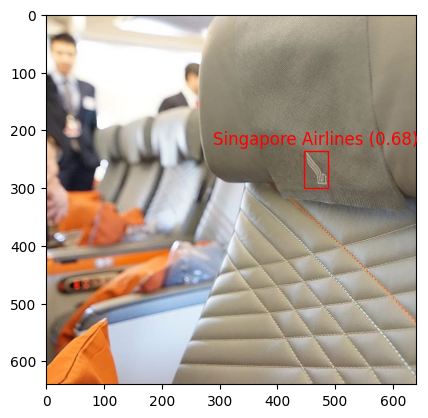

[(93, 259), (448, 259), (448, 303), (93, 303)]


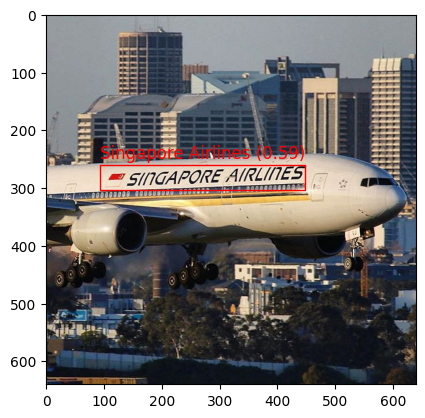

[(487, 281), (537, 281), (537, 336), (487, 336)]


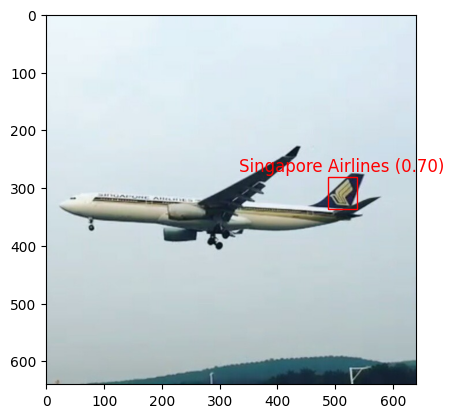

[(744, 352), (845, 352), (845, 442), (744, 442)]


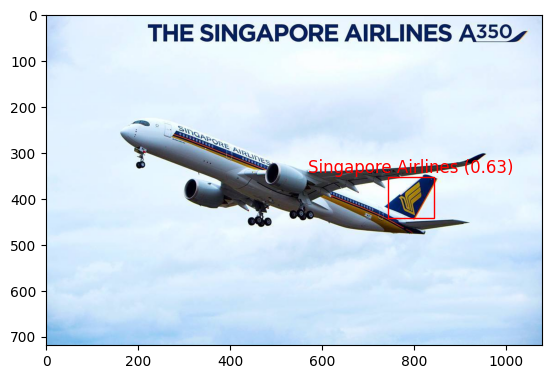

[(155, 171), (331, 171), (331, 370), (155, 370)]


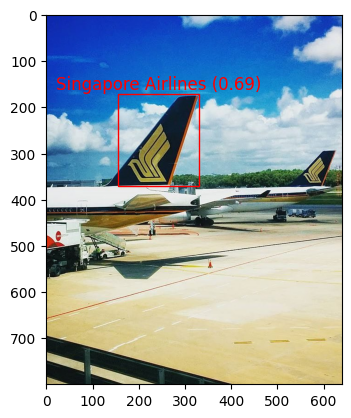

[(376, 329), (782, 329), (782, 509), (376, 509)]


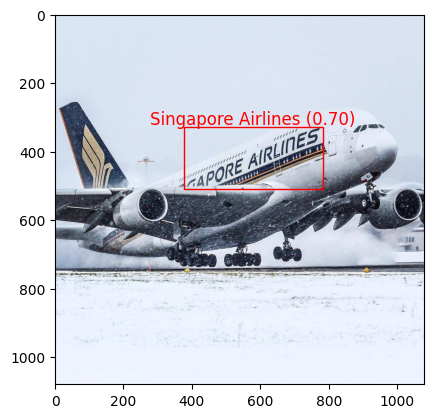

[(4, 254), (192, 254), (192, 513), (4, 513)]


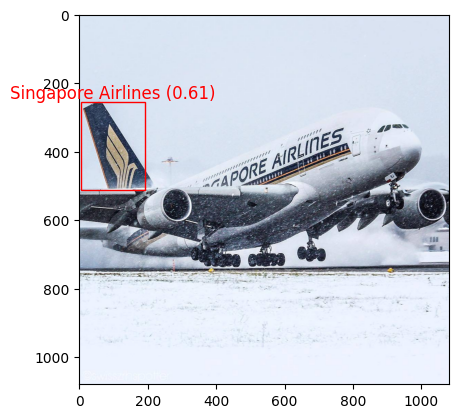

[(178, 159), (385, 159), (385, 185), (178, 185)]


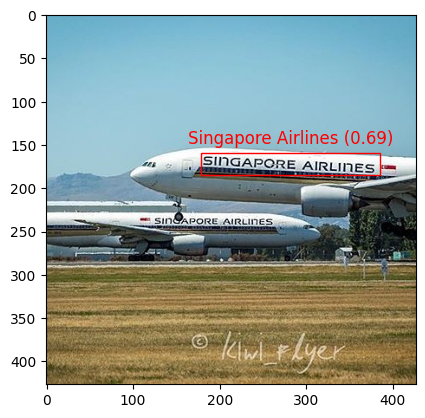

[(252, 283), (477, 283), (477, 370), (252, 370)]


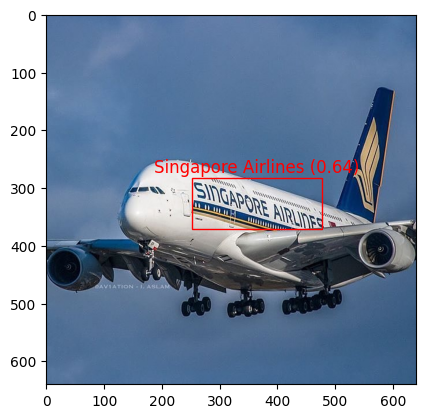

[(501, 344), (969, 344), (969, 486), (501, 486)]


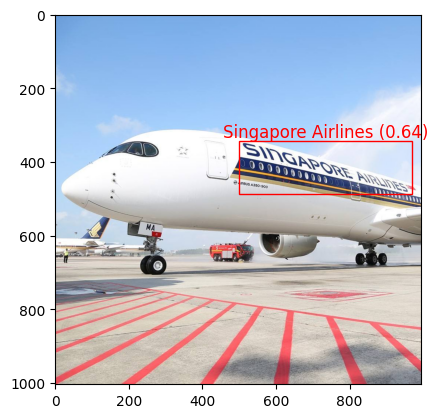

[(365, 327), (782, 327), (782, 508), (365, 508)]


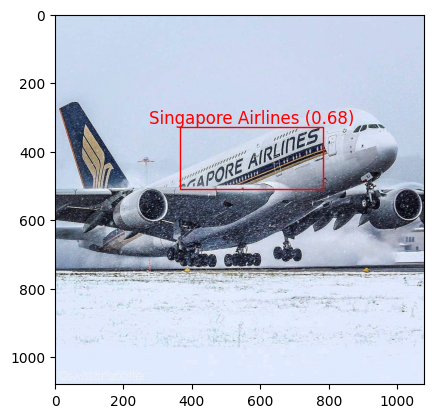

[(11, 256), (195, 256), (195, 517), (11, 517)]


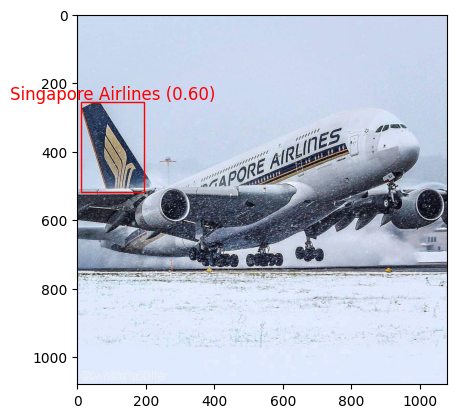

[(335, 226), (544, 226), (544, 285), (335, 285)]


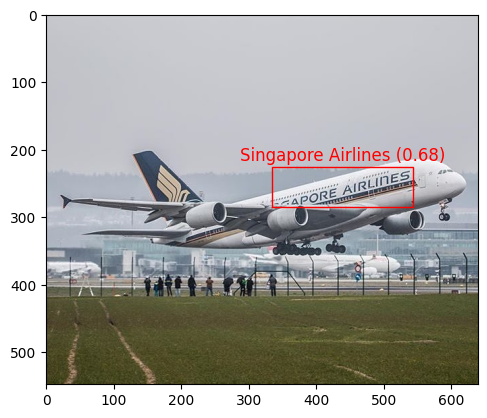

[(137, 206), (225, 206), (225, 285), (137, 285)]


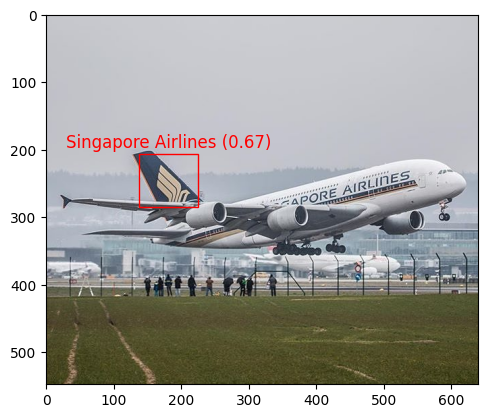

[(404, 278), (451, 278), (451, 323), (404, 323)]


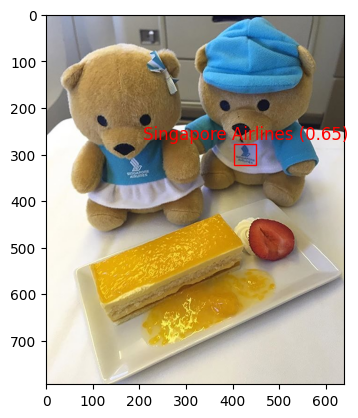

[(802, 415), (870, 415), (870, 476), (802, 476)]


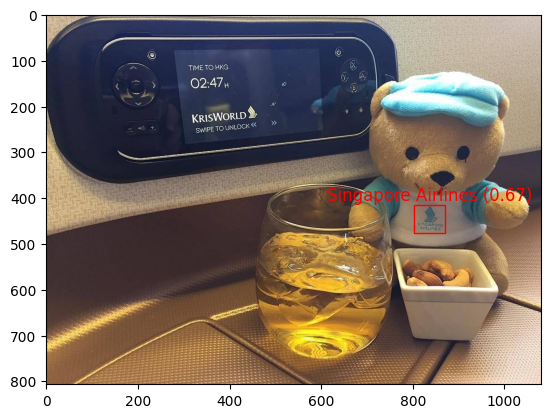

[(857, 87), (979, 87), (979, 149), (857, 149)]


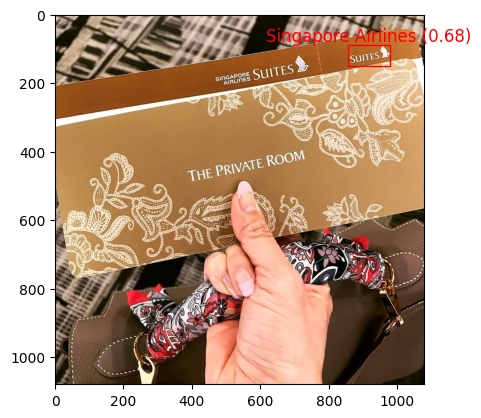

[(484, 523), (842, 523), (842, 754), (484, 754)]


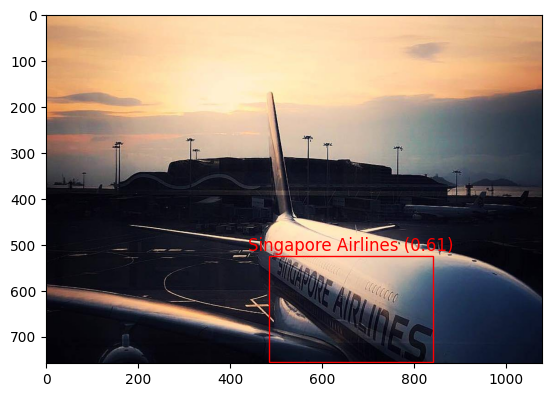

[(787, 362), (1007, 362), (1007, 397), (787, 397)]


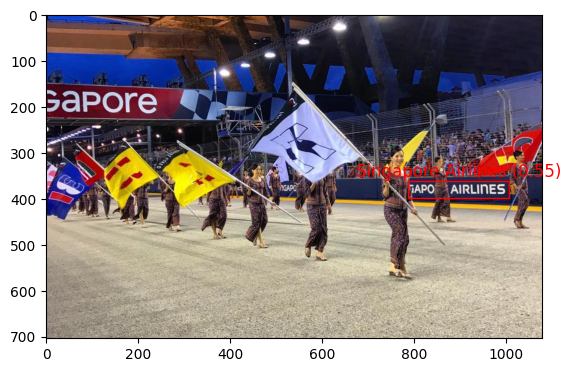

[(45, 328), (648, 328), (648, 430), (45, 430)]


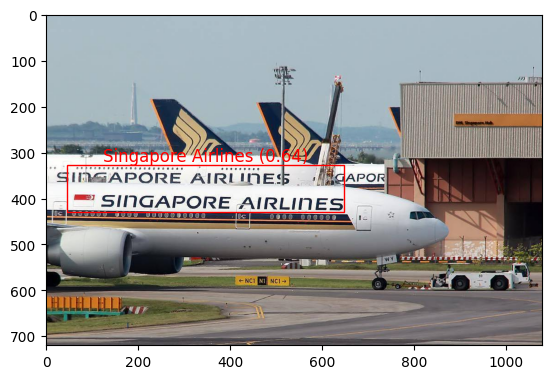

[(618, 332), (673, 332), (673, 391), (618, 391)]


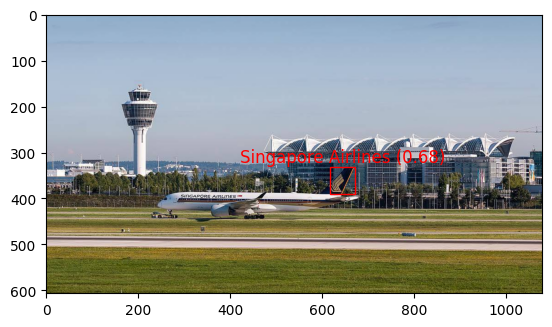

[(387, 306), (726, 306), (726, 454), (387, 454)]


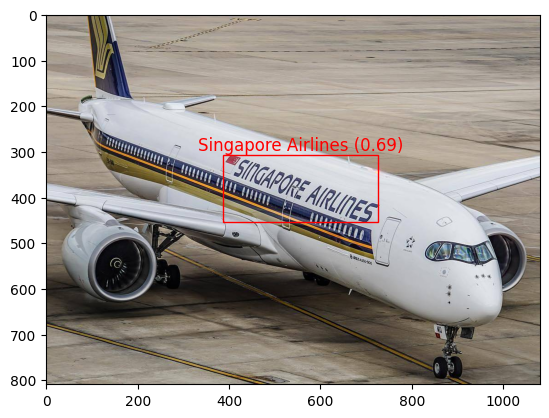

[(73, 148), (424, 148), (424, 206), (73, 206)]


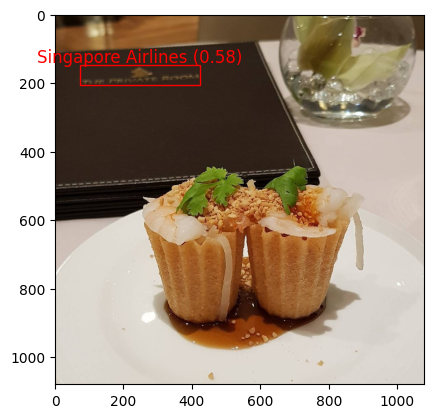

[(575, 180), (652, 180), (652, 310), (575, 310)]


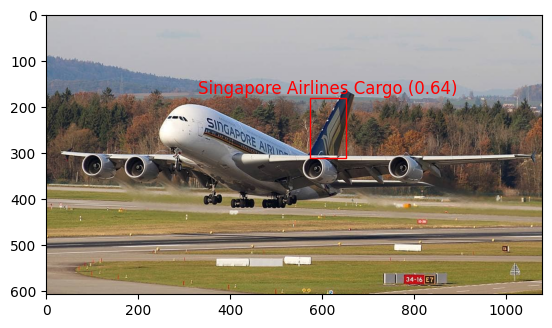

[(213, 269), (503, 269), (503, 351), (213, 351)]


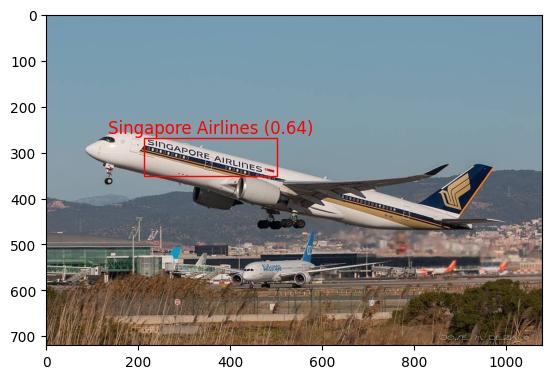

[(490, 466), (735, 466), (735, 505), (490, 505)]


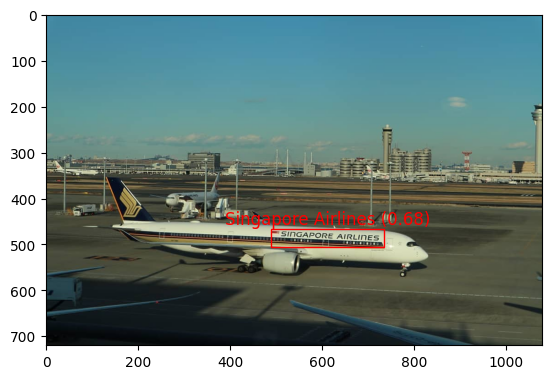

[(169, 183), (422, 183), (422, 275), (169, 275)]


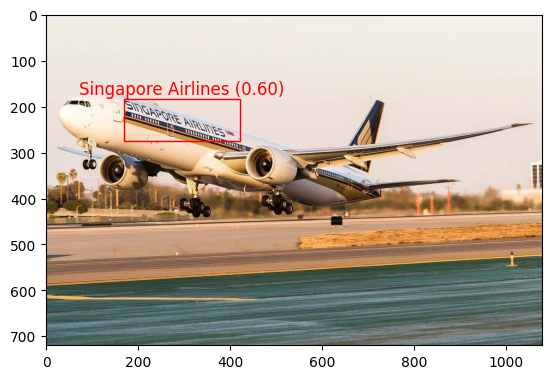

[(184, 304), (494, 304), (494, 362), (184, 362)]


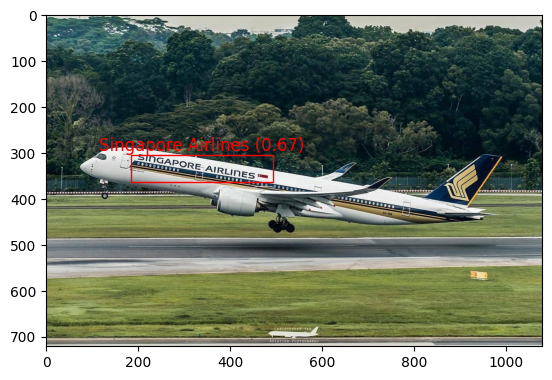

[(653, 403), (882, 403), (882, 497), (653, 497)]


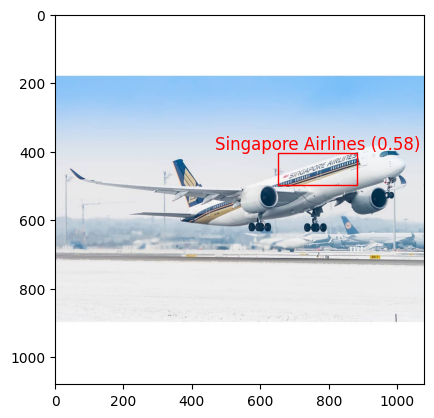

[(862, 475), (930, 475), (930, 568), (862, 568)]


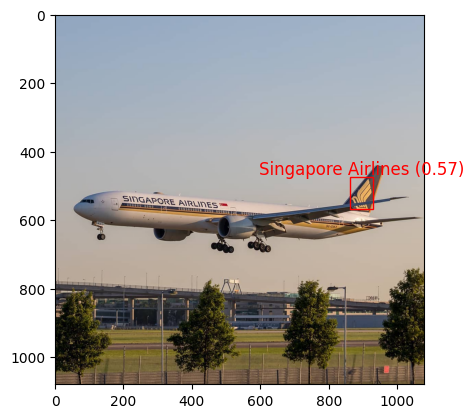

[(839, 404), (933, 404), (933, 519), (839, 519)]


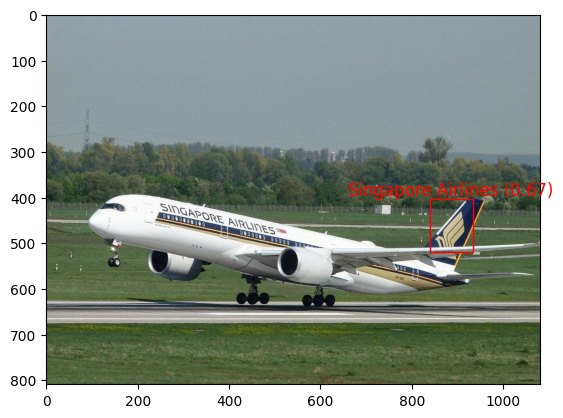

[(579, 448), (795, 448), (795, 489), (579, 489)]


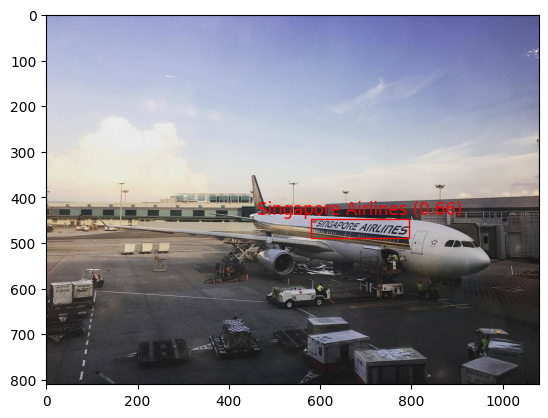

[(319, 432), (540, 432), (540, 501), (319, 501)]


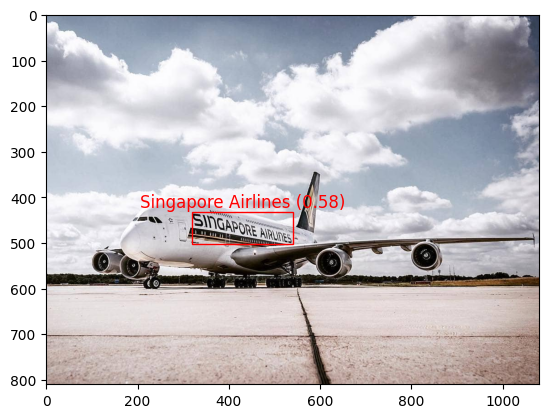

[(551, 275), (670, 275), (670, 358), (551, 358)]


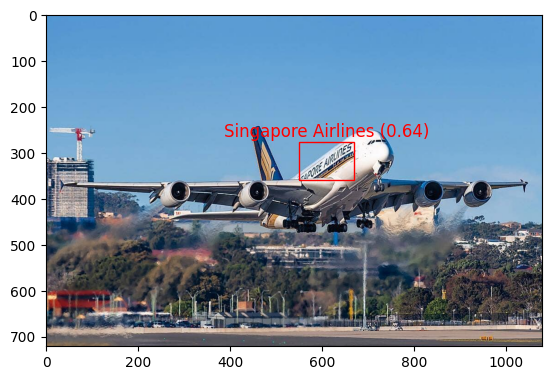

[(449, 253), (506, 253), (506, 360), (449, 360)]


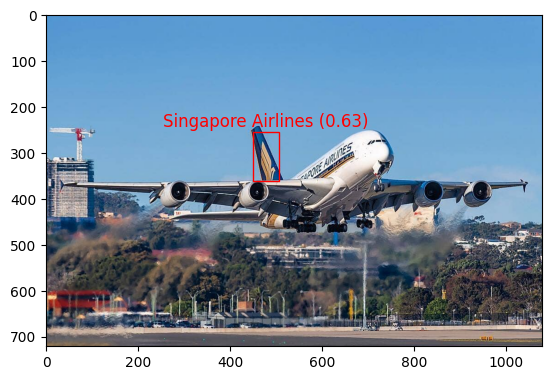

[(264, 449), (568, 449), (568, 542), (264, 542)]


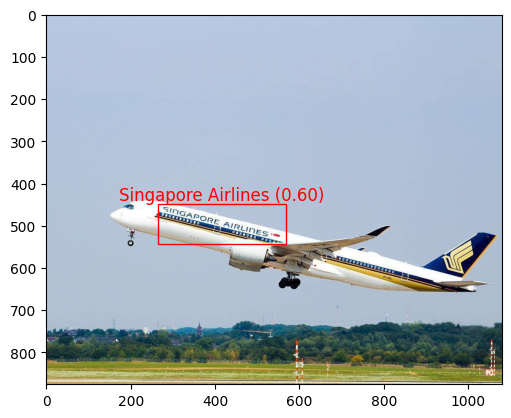

[(36, 686), (288, 686), (288, 734), (36, 734)]


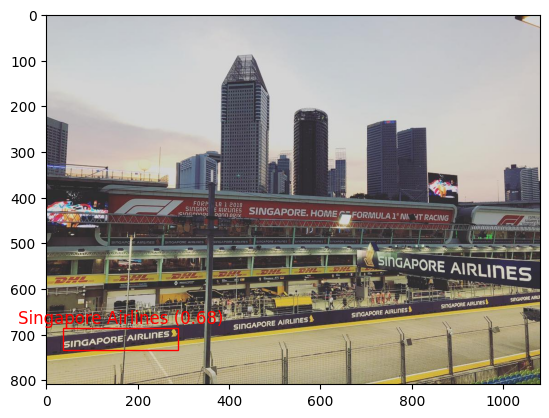

[(172, 70), (942, 70), (942, 153), (172, 153)]


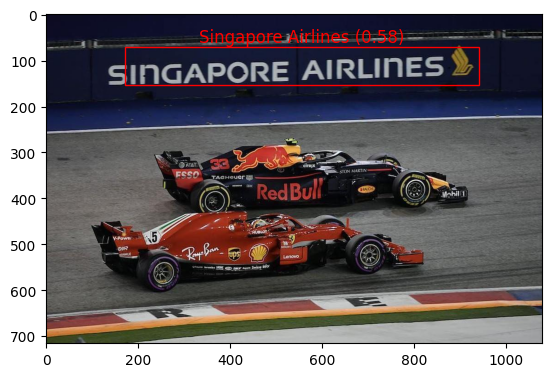

[(163, 288), (460, 288), (460, 342), (163, 342)]


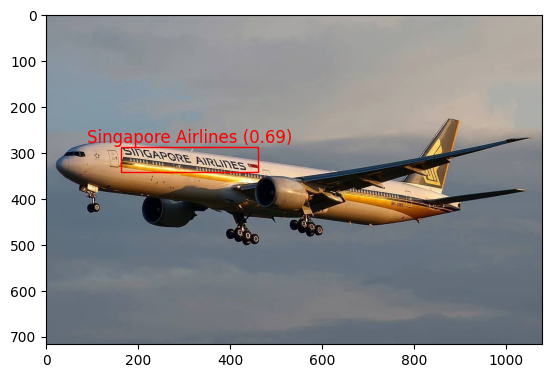

[(775, 409), (912, 409), (912, 480), (775, 480)]


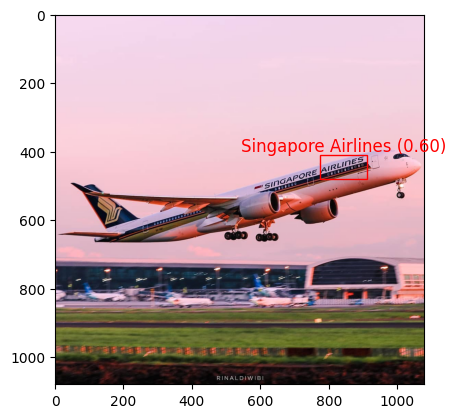

[(470, 294), (773, 294), (773, 339), (470, 339)]


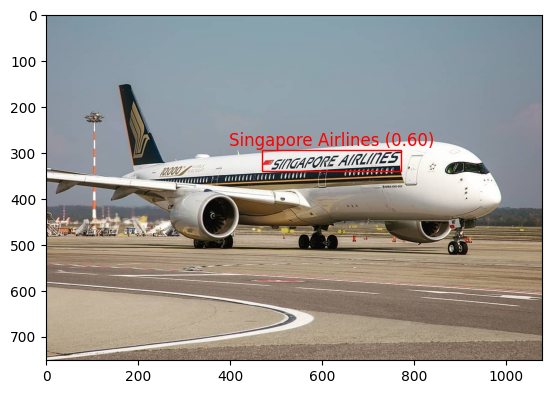

[(209, 409), (536, 409), (536, 494), (209, 494)]


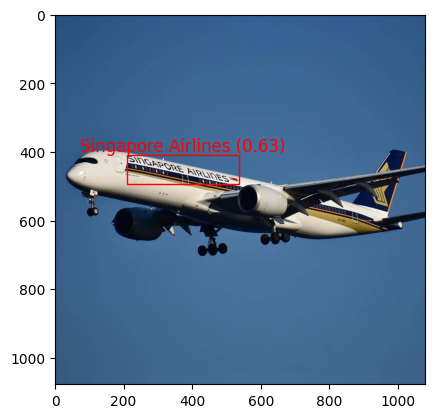

[(427, 276), (632, 276), (632, 354), (427, 354)]


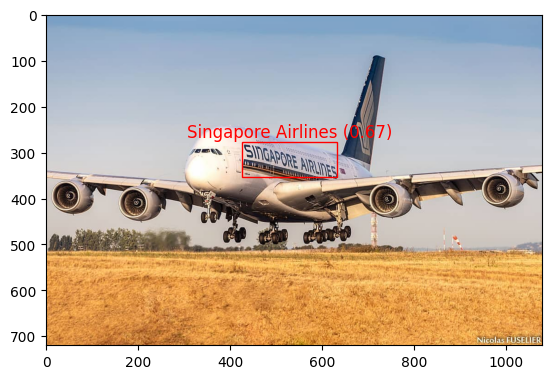

[(402, 326), (590, 326), (590, 389), (402, 389)]


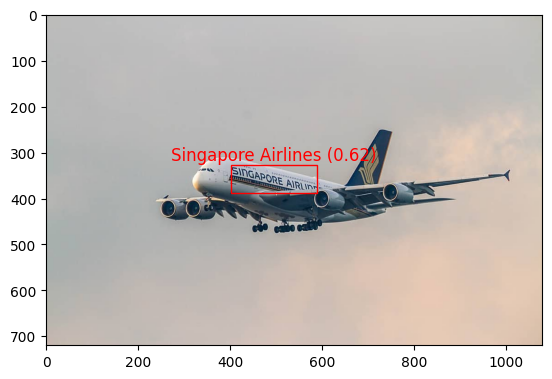

[(229, 263), (632, 263), (632, 295), (229, 295)]


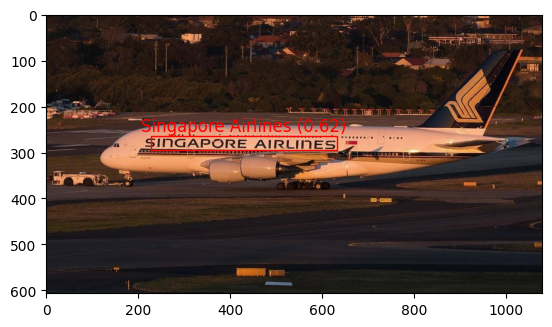

[(161, 224), (495, 224), (495, 334), (161, 334)]


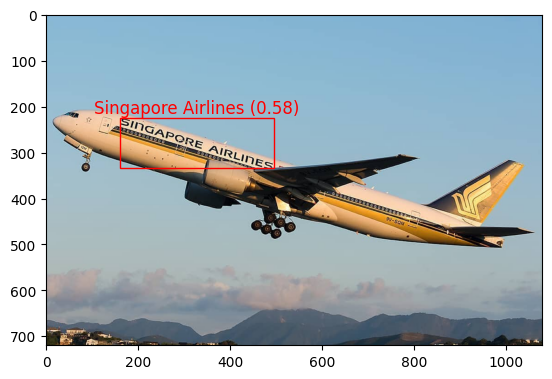

[(208, 371), (500, 371), (500, 418), (208, 418)]


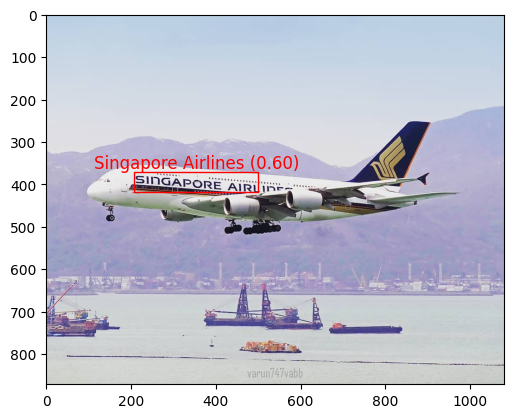

[(167, 405), (247, 405), (247, 483), (167, 483)]


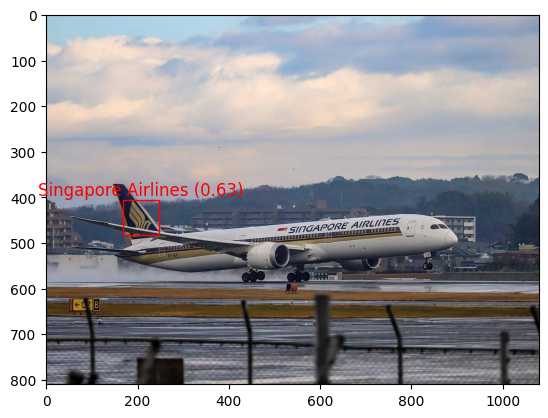

[(7, 248), (351, 248), (351, 387), (7, 387)]


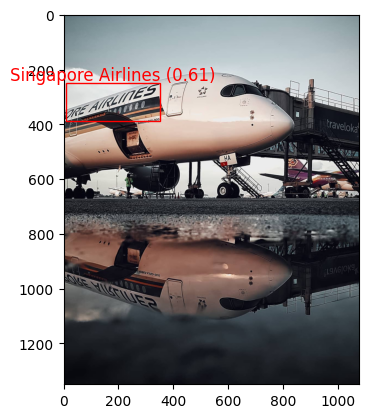

[(186, 57), (371, 57), (371, 109), (186, 109)]


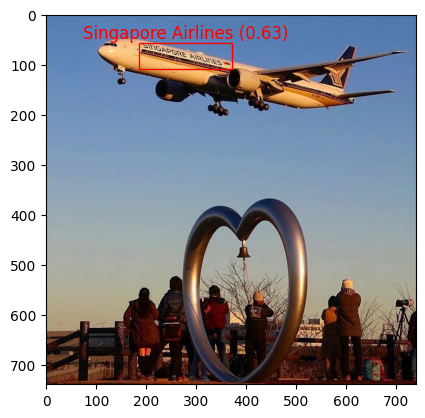

In [30]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import re

# Filter the DataFrame to keep only relevant descriptions and where Confidence < 0.7
filtered_df = combined_df[
    (combined_df["Description"].str.contains("Lufthansa|Singapore Airlines|Star Alliance", case=False, na=False)) &
    (combined_df["Confidence"] < 0.7)
]

for index, row in filtered_df.iterrows():
    image_path = row["path"]
    description = row["Description"]
    confidence = row["Confidence"]
    vertices = row["Vertices"]

    # Define a regular expression pattern to match the part starting with numbers
    pattern = r"(\d.*)"

    # Use re.search to find the first match
    match = re.search(pattern, image_path).group(1)
    image_path= dir+ match


    # Open the image using PIL and convert it to RGB mode
    image = Image.open(image_path).convert("RGB")

    # Create a figure and axis
    fig, ax = plt.subplots()

    # Display the image
    ax.imshow(image)

    # Unpack the vertices for the bounding box
    print(vertices)
    (x0, y0), (x1, _), (x2, y2), (_, _) = vertices

    # Calculate width and height of the rectangle
    rect_width = x2 - x0
    rect_height = y2 - y0

    # Create a rectangle patch
    rect = patches.Rectangle((x0, y0), rect_width, rect_height, linewidth=1, edgecolor='r', facecolor='none')
    ax.add_patch(rect)

    # Add the logo description and confidence as text
    text = f"{description} ({confidence:.2f})"
    plt.text(x0 + rect_width / 2, y0 - 10, text, fontsize=12, color='r', ha='center')

    # Show the plot
    plt.show()


[(161, 306), (348, 306), (348, 375), (161, 375)]


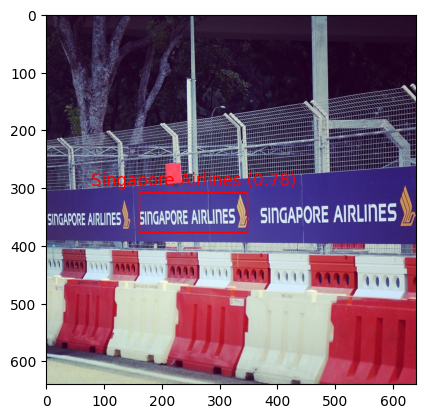

[(370, 292), (637, 292), (637, 366), (370, 366)]


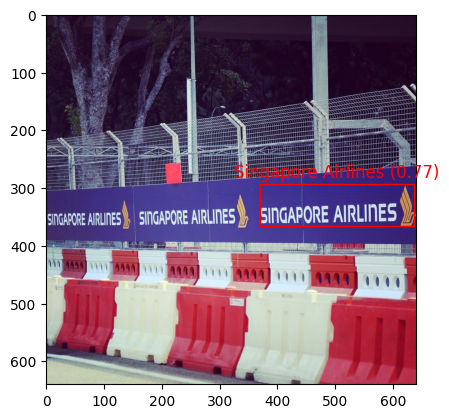

[(483, 266), (560, 266), (560, 321), (483, 321)]


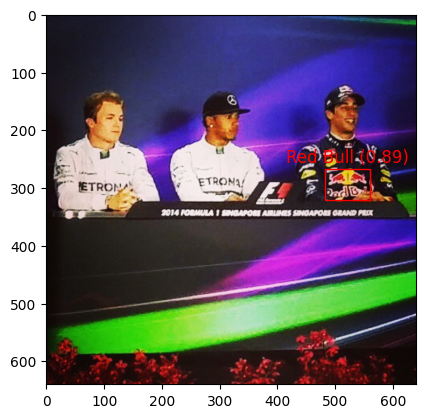

[(359, 288), (425, 288), (425, 330), (359, 330)]


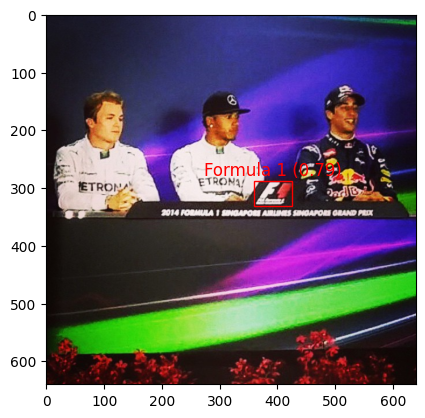

[(594, 205), (627, 205), (627, 354), (594, 354)]


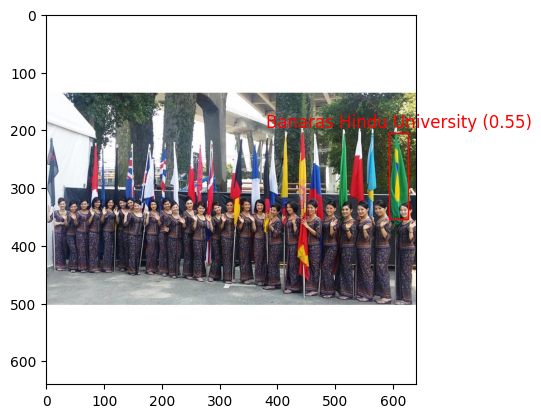

[(255, 378), (290, 378), (290, 411), (255, 411)]


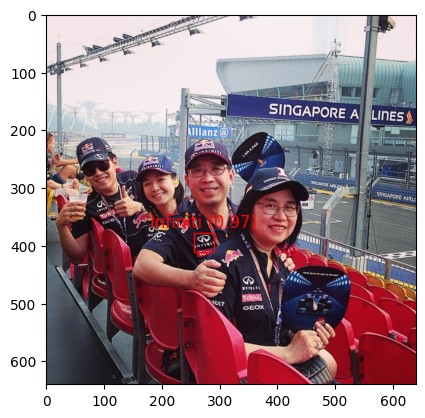

[(303, 404), (343, 404), (343, 437), (303, 437)]


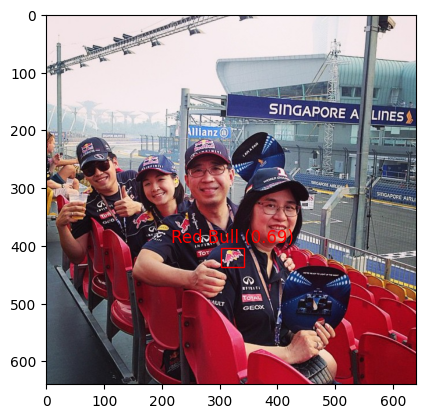

[(170, 360), (215, 360), (215, 397), (170, 397)]


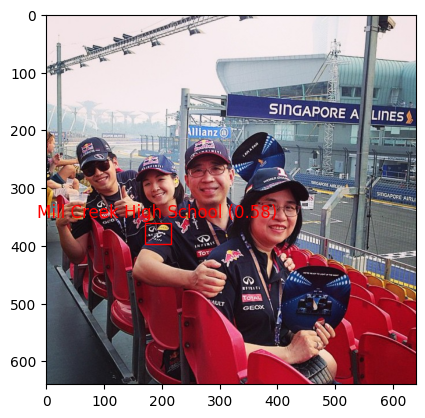

[(232, 136), (405, 136), (405, 241), (232, 241)]


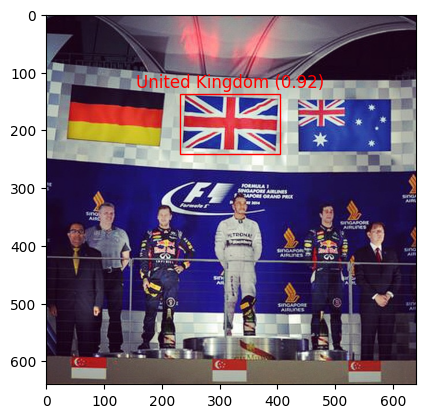

[(398, 463), (453, 463), (453, 514), (398, 514)]


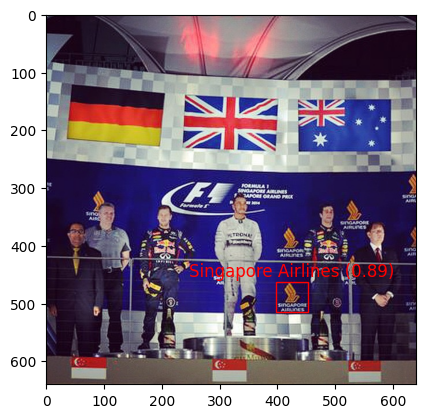

In [13]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import re
# Loop through each row in the DataFrame


for index, row in combined_df[10:20].iterrows():
    image_path = row["path"]
    description = row["Description"]
    confidence = row["Confidence"]
    vertices = row["Vertices"]

    # Define a regular expression pattern to match the part starting with numbers
    pattern = r"(\d.*)"

    # Use re.search to find the first match
    match = re.search(pattern, image_path).group(1)
    image_path= dir+ match


    # Open the image using PIL and convert it to RGB mode
    image = Image.open(image_path).convert("RGB")

    # Create a figure and axis
    fig, ax = plt.subplots()

    # Display the image
    ax.imshow(image)

    # Unpack the vertices for the bounding box
    print(vertices)
    (x0, y0), (x1, _), (x2, y2), (_, _) = vertices

    # Calculate width and height of the rectangle
    rect_width = x2 - x0
    rect_height = y2 - y0

    # Create a rectangle patch
    rect = patches.Rectangle((x0, y0), rect_width, rect_height, linewidth=1, edgecolor='r', facecolor='none')
    ax.add_patch(rect)

    # Add the logo description and confidence as text
    text = f"{description} ({confidence:.2f})"
    plt.text(x0 + rect_width / 2, y0 - 10, text, fontsize=12, color='r', ha='center')

    # Show the plot
    plt.show()


# Load in all data and create single csv file 

In [45]:
%env SPARK_LOCAL_HOSTNAME=localhost

import findspark
# initialize findspark with spark directory
findspark.init("C:\Spark\spark-3.4.1-bin-hadoop3")
# import pyspark
import pyspark

from pyspark import SparkConf, SparkContext
conf = SparkConf().setMaster("local").setAppName("Test")
sc = SparkContext(conf = conf)
spark = pyspark.sql.SparkSession(sc)

env: SPARK_LOCAL_HOSTNAME=localhost


In [47]:
import pandas as pd
from pyspark.sql import SparkSession
from pyspark.sql.types import StructType, StructField, StringType, DoubleType, ArrayType, IntegerType
from pyspark.sql.functions import regexp_extract

# Create a SparkSession
spark = SparkSession.builder.appName("PandasToSpark").getOrCreate()

# Define the schema for your DataFrame
schema = StructType([
    StructField("path", StringType(), True),
    StructField("Description", StringType(), True),
    StructField("Confidence", DoubleType(), True),
])

# Create an empty PySpark DataFrame with the defined schema
logo_df = spark.createDataFrame([], schema)

# List of file paths to read
paths = [

    "../additional_data/Google_API_results_logos/results_lufthansa_usa_tagged_part1.csv",
    "../additional_data/Google_API_results_logos/results_lufthansa_usa_tagged_part2.csv",
    "../additional_data/Google_API_results_logos/results_singaporeair_tagged.csv",
    "../additional_data/Google_API_results_logos/results_singaporeair.csv",
    "../additional_data/Google_API_results_logos/results_lufthansa_usa.csv"
]

# Read and convert each file to a PySpark DataFrame
for path in paths:
    try:
        # Read the CSV file into a Pandas DataFrame
        pandas_df = pd.read_csv(path, sep=";")
        
        # Drop the 'Vertices' column from the Pandas DataFrame
        pandas_df.drop("Vertices", axis=1, inplace=True)
        
        # Convert the modified Pandas DataFrame to a PySpark DataFrame
        spark_df = spark.createDataFrame(pandas_df, schema=schema)
        
        # Union the current PySpark DataFrame with the main DataFrame
        logo_df = logo_df.union(spark_df)
        
        print(f"Number of rows in {path}: {spark_df.count()}")
    except Exception as e:
        print(f"Error processing file {path}: {e}")

# Cache the DataFrame
logo_df = logo_df.cache()

# Extract a new column called 'name'
logo_df = logo_df.withColumn("name", regexp_extract("path", "/([^/]*)$", 1)).orderBy("name")

# Show the combined DataFrame
logo_df.show(truncate=False)


Number of rows in ../additional_data/results_logos/results_lufthansa_usa_tagged_part1.csv: 3342
Number of rows in ../additional_data/results_logos/results_lufthansa_usa_tagged_part2.csv: 10966
Number of rows in ../additional_data/results_logos/results_singaporeair_tagged.csv: 88
Number of rows in ../additional_data/results_logos/results_singaporeair.csv: 607
Number of rows in ../additional_data/results_logos/results_lufthansa_usa.csv: 623
+-------------------------------------------------+-----------------------------+------------------+---------------------------+
|path                                             |Description                  |Confidence        |name                       |
+-------------------------------------------------+-----------------------------+------------------+---------------------------+
|../data/lufthansa_usa/2012-10-11_17-21-43_UTC.jpg|Lufthansa                    |0.7830049991607666|2012-10-11_17-21-43_UTC.jpg|
|../data/lufthansa_usa/2012-10-11_17-24-0

In [48]:
from pyspark.sql import functions as F

# Group by the 'Description' column and count the occurrences of each description
description_counts = logo_df.groupBy("Description").count().orderBy("count", ascending=False)

# Show the count of different descriptions
description_counts.show(truncate=False)


+-------------------------------+-----+
|Description                    |count|
+-------------------------------+-----+
|Lufthansa                      |9716 |
|Star Alliance                  |433  |
|Singapore Airlines             |377  |
|Lufthansa Cargo                |240  |
|British Airways                |96   |
|LSG Sky Chefs                  |86   |
|United Airlines                |81   |
|GeminiJets                     |79   |
|Emirates                       |76   |
|Lufthansa Systems              |54   |
|Korean Air                     |44   |
|Air France                     |43   |
|Alaska Airlines                |35   |
|Boeing                         |33   |
|Qatar Airways                  |32   |
|American Airlines              |32   |
|LIU Post                       |31   |
|Swiss International Air Lines  |27   |
|Monetary Authority of Singapore|25   |
|Qantas                         |25   |
+-------------------------------+-----+
only showing top 20 rows



In [49]:
from pyspark.sql.functions import col

# Filter the DataFrame to only keep relevant logos
filtered_df = logo_df.filter(
    (col("Description").like("%Lufthansa%")) |
    (col("Description").like("%Singapore Airlines%")) |
    (col("Description").like("%Star Alliance%")))\
    .dropDuplicates(["name"])

# Show the filtered DataFrame
filtered_df.show(truncate=False)
filtered_df.count()


+-------------------------------------------------+-----------+------------------+---------------------------+
|path                                             |Description|Confidence        |name                       |
+-------------------------------------------------+-----------+------------------+---------------------------+
|../data/lufthansa_usa/2012-10-11_17-21-43_UTC.jpg|Lufthansa  |0.7830049991607666|2012-10-11_17-21-43_UTC.jpg|
|../data/lufthansa_usa/2012-10-11_17-24-02_UTC.jpg|Lufthansa  |0.9431076645851136|2012-10-11_17-24-02_UTC.jpg|
|../data/lufthansa_usa/2012-10-17_15-36-02_UTC.jpg|Lufthansa  |0.9701882600784302|2012-10-17_15-36-02_UTC.jpg|
|../data/lufthansa_usa/2012-12-02_17-37-19_UTC.jpg|Lufthansa  |0.8783769607543945|2012-12-02_17-37-19_UTC.jpg|
|../data/lufthansa_usa/2013-10-19_13-12-51_UTC.jpg|Lufthansa  |0.9681037068367004|2013-10-19_13-12-51_UTC.jpg|
|../data/lufthansa_usa/2013-11-11_15-04-10_UTC.jpg|Lufthansa  |0.9576227068901062|2013-11-11_15-04-10_UTC.jpg|
|

8462

In [50]:
# Group by the 'Description' column and count the occurrences of each description
description_counts = filtered_df.groupBy("Description").count().orderBy("count", ascending=False)

# Show the count of different descriptions
description_counts.show(truncate=False)


+------------------------+-----+
|Description             |count|
+------------------------+-----+
|Lufthansa               |7715 |
|Singapore Airlines      |300  |
|Star Alliance           |200  |
|Lufthansa Cargo         |186  |
|Lufthansa Systems       |32   |
|Singapore Airlines Cargo|23   |
|Lufthansa Technik       |4    |
|Lufthansa CityLine      |2    |
+------------------------+-----+



In [51]:
# Convert the PySpark DataFrame to a Pandas DataFrame
pandas_df = filtered_df.toPandas()

# Specify the path where you want to save the CSV file
output_path = "../additional_data/logo_prediction_combined.csv"

# Save the Pandas DataFrame to a CSV file
pandas_df.to_csv(output_path, index=False)


# Label prediction

## Calls to API and storing results in a csv file

In [18]:
dataset= "lufthansa_usa/"
name_file= "lufthansa_usa"
dir=f"../data/{dataset}"

In [53]:
# get all the names of the jpg files in our Data repository
pic_names= [obs for obs in os.listdir(dir) if "jpg" in obs]
pic_paths = [os.path.join(dir, obs) for obs in pic_names]
pic_paths= pic_paths
len(pic_paths)


2116

In [54]:
import datetime

dfs_batches = []
# Assuming pic_paths is a list of image paths
batch_size = 10
for i in range(0, len(pic_paths), batch_size):

    batch_paths = pic_paths[i:i + batch_size]
    df= detect_labels_batch(batch_paths)
    if df is not None:
        dfs_batches.append(df)
    if i%500==0:
        print(i)
        now = datetime.datetime.now()
        print(now)

0
2023-12-16 15:00:31.407174
500
2023-12-16 15:02:20.342028
1000
2023-12-16 15:04:29.073791
1500
2023-12-16 15:06:41.665853
2000
2023-12-16 15:08:52.191360


In [ ]:
if dfs_batches:
    print("The dataframe is not empty.")
    combined_df = pd.concat(dfs_batches, ignore_index=True)

    # Save the DataFrame to a CSV file
    output_file = f"../additional_data/results_labels/results_{name_file}_labels.csv"
    print(output_file)
    combined_df.to_csv(output_file, index=False, sep=";")

'../data/./lufthansa_usa//'

# Load date from csv and visualize

In [9]:
combined_df= pd.read_csv( f"../additional_data/results_labels/results_{name_file}_labels.csv" ,sep=";")
combined_df

,path,Description,Confidence
0,./data/./lufthansa_usa//2012-10-11_17-21-43_UT...,Product,0.907244
1,./data/./lufthansa_usa//2012-10-11_17-21-43_UT...,Font,0.814161
2,./data/./lufthansa_usa//2012-10-11_17-21-43_UT...,Toy,0.805983
3,./data/./lufthansa_usa//2012-10-11_17-21-43_UT...,"Ducks, geese and swans",0.747747
4,./data/./lufthansa_usa//2012-10-11_17-21-43_UT...,Bath toy,0.735390
...,...,...,...
21074,./data/./lufthansa_usa//2020-11-10_13-00-19_UT...,Symbol,0.573469
21075,./data/./lufthansa_usa//2020-11-10_13-00-19_UT...,Font,0.804977
21076,./data/./lufthansa_usa//2020-11-10_13-00-19_UT...,Brand,0.674163
21077,./data/./lufthansa_usa//2020-11-10_13-00-19_UT...,Logo,0.642963


2012-10-11_17-21-43_UTC.jpg


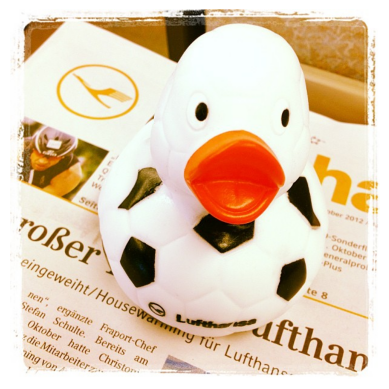

Image: ../data/lufthansa_usa/2012-10-11_17-21-43_UTC.jpg
	Description: Product, Confidence: 0.9072439670562744
	Description: Font, Confidence: 0.8141614198684692
	Description: Toy, Confidence: 0.8059833645820618
	Description: Ducks, geese and swans, Confidence: 0.7477469444274902
	Description: Bath toy, Confidence: 0.7353904843330383
	Description: Poster, Confidence: 0.7283415794372559
	Description: Beak, Confidence: 0.6853964924812317
	Description: Logo, Confidence: 0.6726048588752747
	Description: Livestock, Confidence: 0.6602077484130859
	Description: Water bird, Confidence: 0.6592252254486084


2012-10-11_17-24-02_UTC.jpg


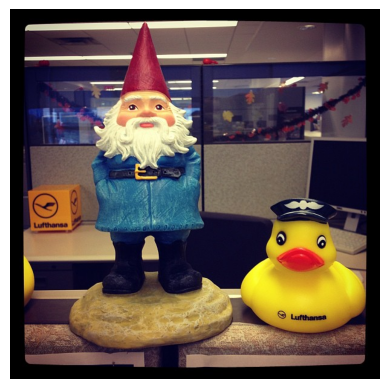

Image: ../data/lufthansa_usa/2012-10-11_17-24-02_UTC.jpg
	Description: Beard, Confidence: 0.9088363647460938
	Description: Toy, Confidence: 0.9087384939193726
	Description: rubber ducky, Confidence: 0.9063785672187804
	Description: Lawn ornament, Confidence: 0.8044679760932922
	Description: Bath toy, Confidence: 0.7875465154647827
	Description: Ducks, geese and swans, Confidence: 0.7853041291236877
	Description: Santa claus, Confidence: 0.7636948823928833
	Description: Garden gnome, Confidence: 0.7560636401176453
	Description: Snapshot, Confidence: 0.7428474426269531
	Description: Waterfowl, Confidence: 0.7417097091674805


2012-10-17_15-36-02_UTC.jpg


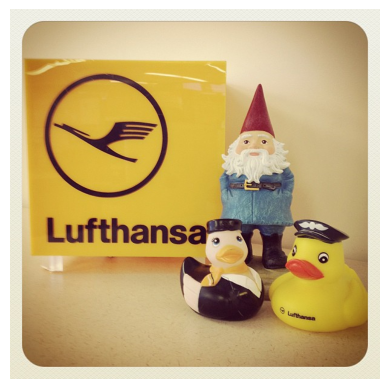

Image: ../data/lufthansa_usa/2012-10-17_15-36-02_UTC.jpg
	Description: Toy, Confidence: 0.8512370586395264
	Description: Rectangle, Confidence: 0.8307185173034668
	Description: Garden gnome, Confidence: 0.7879132628440857
	Description: Tree, Confidence: 0.7810476422309875
	Description: Santa claus, Confidence: 0.7216386198997498
	Description: Art, Confidence: 0.7129116058349609
	Description: rubber ducky, Confidence: 0.6943891048431396
	Description: Christmas, Confidence: 0.6886893510818481
	Description: Event, Confidence: 0.685871422290802
	Description: Ornament, Confidence: 0.66375333070755


2012-10-23_21-02-50_UTC.jpg


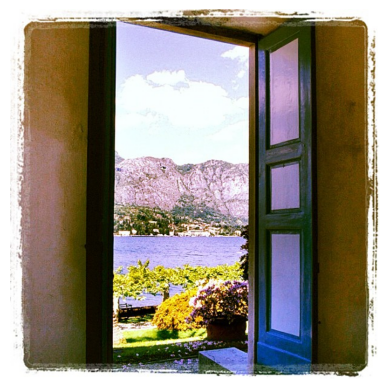

Image: ../data/lufthansa_usa/2012-10-23_21-02-50_UTC.jpg
	Description: Water, Confidence: 0.9638636112213136
	Description: Plant, Confidence: 0.9242821335792542
	Description: Rectangle, Confidence: 0.8976317048072815
	Description: Purple, Confidence: 0.8779283165931702
	Description: Window, Confidence: 0.870900571346283
	Description: Liquid, Confidence: 0.8450680375099182
	Description: Flower, Confidence: 0.8350152373313904
	Description: Cloud, Confidence: 0.7971943616867065
	Description: Lake, Confidence: 0.7924306392669678
	Description: Sky, Confidence: 0.7831333875656128


2012-10-25_14-27-28_UTC.jpg


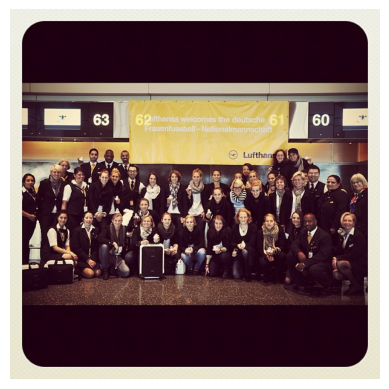

Image: ../data/lufthansa_usa/2012-10-25_14-27-28_UTC.jpg
	Description: Product, Confidence: 0.9081628322601318
	Description: Rectangle, Confidence: 0.8967849612236023
	Description: Font, Confidence: 0.855204701423645
	Description: Music, Confidence: 0.7920520901679993
	Description: Suit, Confidence: 0.7745210528373718
	Description: Technology, Confidence: 0.7520021796226501
	Description: Gadget, Confidence: 0.7465320229530334
	Description: Snapshot, Confidence: 0.742847204208374
	Description: Electronic device, Confidence: 0.7419347167015076
	Description: Crew, Confidence: 0.7184953689575195


2012-11-28_15-13-52_UTC.jpg


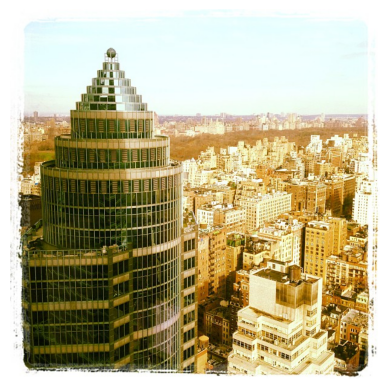

Image: ../data/lufthansa_usa/2012-11-28_15-13-52_UTC.jpg
	Description: Building, Confidence: 0.961789608001709
	Description: Skyscraper, Confidence: 0.9326003789901732
	Description: Sky, Confidence: 0.926372766494751
	Description: World, Confidence: 0.8714295625686646
	Description: Urban design, Confidence: 0.8501792550086975
	Description: Tower block, Confidence: 0.833708643913269
	Description: Condominium, Confidence: 0.828262448310852
	Description: Rectangle, Confidence: 0.8193153142929077
	Description: Window, Confidence: 0.810165286064148
	Description: Tower, Confidence: 0.8044058084487915


2012-12-02_17-37-19_UTC.jpg


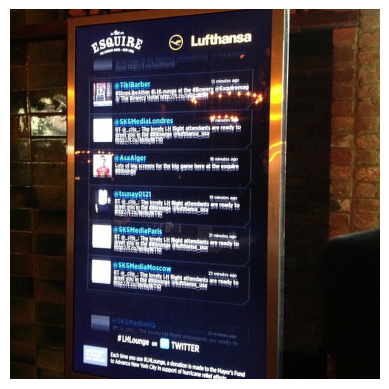

Image: ../data/lufthansa_usa/2012-12-02_17-37-19_UTC.jpg
	Description: Television, Confidence: 0.8820228576660156
	Description: Television set, Confidence: 0.8094130158424377
	Description: Display device, Confidence: 0.7715871334075928
	Description: Font, Confidence: 0.7708125710487366
	Description: Flat panel display, Confidence: 0.7578401565551758
	Description: Electronic device, Confidence: 0.7443331480026245
	Description: Technology, Confidence: 0.7388856410980225
	Description: Multimedia, Confidence: 0.7269986867904663
	Description: Machine, Confidence: 0.7132222652435303
	Description: Led-backlit lcd display, Confidence: 0.6933276653289795


2012-12-02_17-57-23_UTC.jpg


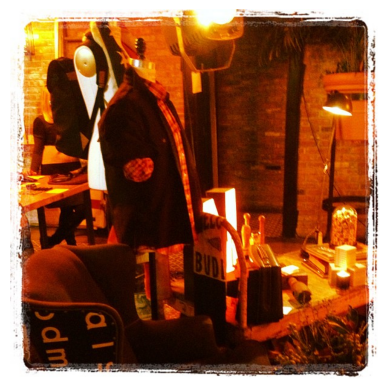

Image: ../data/lufthansa_usa/2012-12-02_17-57-23_UTC.jpg
	Description: Orange, Confidence: 0.8713952302932739
	Description: Rectangle, Confidence: 0.8415548205375671
	Description: Hat, Confidence: 0.8301283717155457
	Description: Event, Confidence: 0.682308554649353
	Description: Heat, Confidence: 0.6555380821228027
	Description: Art, Confidence: 0.6455493569374084
	Description: Music, Confidence: 0.5770488381385803
	Description: Font, Confidence: 0.5703674554824829
	Description: Room, Confidence: 0.5563063621520996
	Description: Musician, Confidence: 0.5386641025543213


2012-12-02_18-39-09_UTC.jpg


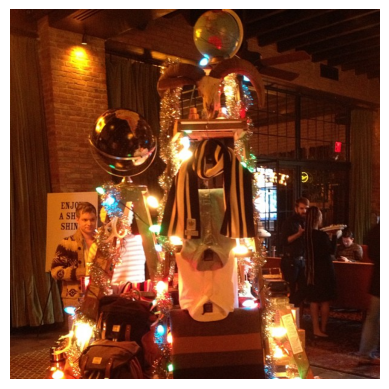

Image: ../data/lufthansa_usa/2012-12-02_18-39-09_UTC.jpg
	Description: Light, Confidence: 0.911483108997345
	Description: Lighting, Confidence: 0.8682626485824585
	Description: Decoration, Confidence: 0.8040404915809631
	Description: Chair, Confidence: 0.7945561408996582
	Description: Tree, Confidence: 0.769432783126831
	Description: Event, Confidence: 0.7489728331565857
	Description: Leisure, Confidence: 0.7438935041427612
	Description: Fun, Confidence: 0.7409511804580688
	Description: Curtain, Confidence: 0.7351573705673218
	Description: Christmas decoration, Confidence: 0.7280956506729126


2012-12-02_19-38-32_UTC.jpg


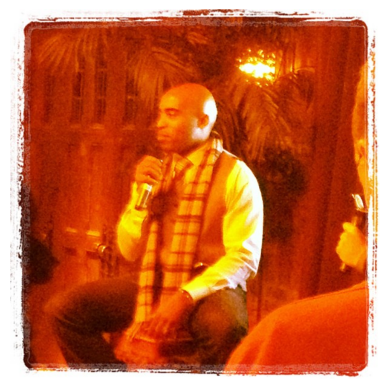

Image: ../data/lufthansa_usa/2012-12-02_19-38-32_UTC.jpg
	Description: Brown, Confidence: 0.9804678559303284
	Description: Rectangle, Confidence: 0.9016880989074708
	Description: Orange, Confidence: 0.8730408549308777
	Description: Sleeve, Confidence: 0.8724481463432312
	Description: Amber, Confidence: 0.8567301034927368
	Description: Art, Confidence: 0.660290539264679
	Description: Square, Confidence: 0.5907769799232483
	Description: Visual arts, Confidence: 0.5382055044174194
	Description: Wood, Confidence: 0.5304327011108398
	Description: Sitting, Confidence: 0.512104868888855




In [27]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
import os

unique_paths = combined_df['path'].unique()

for path in unique_paths[:10]:
    # due to potential file_paths, apply regex. 
    match = re.search(r'\d.*', path)
    extracted_string = match.group()
    print(extracted_string)
    adapted_path=dir+extracted_string
    # Display the image
    if os.path.exists(adapted_path):  # Check if the file exists
        
        img = Image.open(adapted_path)
        plt.imshow(img)
        plt.axis('off')  # Turn off axis numbers
        plt.show()

        print(f"Image: {adapted_path}")
        subset_df = combined_df[combined_df['path'] == path]
        for index, row in subset_df.iterrows():
            print(f"\tDescription: {row['Description']}, Confidence: {row['Confidence']}")
        print("\n")
    else:
        print(f"File not found: {path}\n")


# Determine random selection of  pictures to train and test ML model for predicting if a picture contains an airplane given the label predictions of the google vision API.

In [28]:
import random
import shutil

In [29]:
dataset_list = ["../data/lufthansa_usa/%3Atagged/","../data/lufthansa_usa/","../data/singaporeair/","../data/singaporeair/%3Atagged/"]

In [188]:
for dataset in dataset_list: 
    dir= dataset
    print("dir",dir)
    # get all the names of the jpg files in our Data repository
    pic_names= [obs for obs in os.listdir(dir) if "jpg" in obs]
    pic_paths = [os.path.join(dir, obs) for obs in pic_names]

    # RANDOMLY SELECT 700 paths 
    # Randomly selecting 700 paths from the list
    random_selected_paths = random.sample(pic_names, 700) if len(pic_names) >= 700 else pic_names
    print(len(random_selected_paths))
    # Copying the files to the new folder
    for file_name in random_selected_paths:
        shutil.copy(os.path.join(dir, file_name), os.path.join("./data/photos_training_ML_has_airplane/photos_training", file_name))

dir ./data/lufthansa_usa/%3Atagged/
700
dir ./data/lufthansa_usa/
700
dir ./data/singaporeair/
700
dir ./data/singaporeair/%3Atagged/
107
